In [48]:
from tensorboard.plugins.hparams import api as hp
from load_dataset import LoadDatasetHelper
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
from brokenaxes import brokenaxes

# Baseline Model

In [25]:
import model_baseline

In [26]:
 def load_baseline_model(model_name = 'final_fix_baseline', dataset = '64px', beta = 0.995, lr = 0.01, dataset_file_path = 'data/datasets/baseline/2013_2019_fixed/64px_baseline'):
    
    w = ''
    if beta in [0, 0.99, 0.995]:
        w = 'w1'
    elif beta in [0.999, 0.9995, 1]:
        w = 'w2'
        
        
    model_name = f'{model_name}_{w}_{lr}'
    baseline_runhandler = model_baseline.RunHandler(model_name = model_name, mode = dataset, tile_size = None, batch_size = 64, dataset_file_path = dataset_file_path)
    hparams = {
            model_baseline.HP_BETA: beta,
            model_baseline.HP_LEARNING_RATE: lr,
            }
    model = model_baseline.get_model(baseline_runhandler.model_name, baseline_runhandler.keras_norm_params, baseline_runhandler.mode, hparams, baseline_runhandler.tile_size)

    weight_file = f'models/{model_name}/{dataset}/weights/beta_{beta}_learning_rate_{lr}/best_model.h5'
    model.load_weights(weight_file)
    return baseline_runhandler, model

In [27]:
def index_test_dataset(baseline_test_dataset, shape = 64*64):
    point_dict = {}
    for data in tqdm(baseline_test_dataset): 
        point_ids, _ = tf.unique(tf.reshape(data[0]['point_id'], shape=shape))
        for point_id in point_ids:
            point_id = point_id.numpy()
            px_ids = data[0]['px_id']
            in_bas = data[0]['in_bas']
            lbl = data[1]['out']
            coords = data[0]['coords']

            mask = data[0]['point_id'] == point_id
            mask = tf.reshape(mask, shape = shape)

            px_ids = tf.boolean_mask(px_ids, mask)
            features = tf.boolean_mask(in_bas, mask)
            lbl = tf.boolean_mask(lbl, mask)
            coords = tf.boolean_mask(coords, mask)

            if point_id not in point_dict:
                point_dict[point_id] = {}
                point_dict[point_id]['coords'] = np.unique(coords.numpy())
                point_dict[point_id]['px_id'] = []
                point_dict[point_id]['features'] = []
                point_dict[point_id]['lbl'] = []
                point_dict[point_id]['collected_pxs'] = 0
            point_dict[point_id]['px_id'].append(px_ids)
            point_dict[point_id]['features'].append(features)
            point_dict[point_id]['lbl'].append(lbl)
            point_dict[point_id]['collected_pxs']+= len(px_ids)
            
        
    return point_dict

In [28]:
# dataset
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/baseline/2013_2019_fixed/64px_baseline',
                                        baseline=True, check_dataset = False,
                                        train_batch_size = 64, val_test_batch_size = 64*64*10,
                                        mode = '64px')
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True        
datasets = load_dataset_helper.get_datasets()

train
test
val_batch
val
val_batch


In [29]:
def get_baseline_performance(model, test_dataset):
    
    results = model.evaluate(test_dataset, verbose = 0)
    # Get metrics
    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results

    # Get f1 score
    f1 = calc_f1(precision, recall)

    return tp, fp, tn, fn, accuracy, precision, recall, f1


In [30]:
# Initialize baseline model
baseline_runhandler, baseline_model = load_baseline_model(dataset = '64px',
                                                          beta = 0.9995,
                                                          lr = 0.1,
                                                          )

# Index points
baseline_point_index = index_test_dataset(datasets['test'], shape = 64*64*10)

train
test
val_batch
val
val_batch
Model: "functional_3"
______________________________________________________________________________________________________________________________________________________
Layer (type)                                                       Output Shape                                                Param #                
in_bas (InputLayer)                                                [(None, 9)]                                                 0                      
______________________________________________________________________________________________________________________________________________________
out (Dense)                                                        (None, 1)                                                   10                     
Total params: 10
Trainable params: 10
Non-trainable params: 0
______________________________________________________________________________________________________________________________

In [92]:
for layer in baseline_model.layers: print(layer.get_config(), layer.get_weights())

{'batch_input_shape': (None, 9), 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'in_bas'} []
{'name': 'out', 'trainable': True, 'dtype': 'float32', 'units': 1, 'activation': 'sigmoid', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Constant', 'config': {'value': array([-4.70148996])}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None} [array([[ 2.6775072 ],
       [-2.7383785 ],
       [-0.21397035],
       [-3.9103875 ],
       [-0.20467903],
       [-0.21123841],
       [-0.00829867],
       [ 0.37702036],
       [ 1.5738763 ]], dtype=float32), array([-1.156464], dtype=float32)]


In [93]:
point_dict

NameError: name 'point_dict' is not defined

In [31]:
def prepare_point(point_dict, baseline_model):
    px_ids = tf.concat(point_dict['px_id'], axis = 0)
    lbl = tf.concat(point_dict['lbl'], axis = 0)
    features = tf.concat(point_dict['features'], axis = 0)
    
    pred = baseline_model.predict(features)
    
    # Sanity check
    for i, px_id in enumerate(px_ids):
        if i != px_id:
            print('Error in pixel order!')
            
    lbl = tf.reshape(lbl, shape = (64,64,1))
    features = tf.reshape(features, shape = (64,64,9))
    pred = tf.reshape(pred, shape = (64,64,1))
    
    return (px_ids, features, pred, lbl)

# Deep Learning Model

In [32]:
import models
def load_model(model_name = 'final_spatial_segmenting_future_double_reduced_conv3d', dataset = '64px_comb', beta = 0.995, lr = 0.01, dropout = 0.0):
    dl_runhandler = models.RunHandler(model_name = model_name,   mode = dataset)
    hparams = {
            models.HP_DROPOUT: dropout,
            models.HP_BETA: beta,
            models.HP_LEARNING_RATE: lr,
            }
    model = models.get_model(dl_runhandler.model_name, dl_runhandler.keras_norm_params, dl_runhandler.mode, hparams, dl_runhandler.tile_size)
    
    weight_file = f'models/{model_name}/{dataset}/weights/dropout_{dropout}_beta_{beta}_learning_rate_{lr}/best_model.h5'
    #weight_file = 'models/final_fix_spatial_segmenting_future_double_reduced_conv3d/64px_comb/weights/dropout_0.0_beta_0.999_learning_rate_0.001/best_model.h5'
    model.load_weights(weight_file)
    return dl_runhandler, model


def calc_f1(precision, recall):
    if precision == 0 or recall == 0:
        f1 = 0
    else:
        f1 = (2*precision*recall)/(precision+recall)
        
    return f1
    

In [33]:
def get_performance_df(model, dl_runhandler):
    col_names = ['point_id','coords','tp', 'fp', 'tn', 'fn', 'accuracy', 'precision', 'recall','jac_coef_bool', 'jac_coef', 'pr_auc', 'f1', 'forest_loss_proportion']
    df_scores = pd.DataFrame(columns = col_names)

    rows = []

    for data in tqdm(dl_runhandler.datasets['test'], total = 4000/64):
        for i in range(data[0]['in_seq'].shape[0]):
            new_row = []
            feat = data[0]['in_seq'][i,:,:,:,:]
            lbl = data[1]['out'][i,:,:,:]
            x = tf.reshape(feat, shape  = 1 + feat.shape)
            y =  tf.reshape(lbl, shape  = 1 + lbl.shape)
            point_id = data[0]['point_id'][i].numpy()[0]
            new_row.append(point_id)

            coords = data[0]['coords'][i].numpy()
            new_row.append(coords)


            results = model.evaluate(x, y, verbose = 0)


            new_row += results[1:]
            # Get metrics
            _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
            forest_pixels = tp+fn

            if forest_pixels == 0:
                precision = 1
                recall = 1

            # Get f1 score
            f1 = calc_f1(precision, recall)

            # Forest loss proportion
            forest_loss_proportion = (forest_pixels)/(64*64)

            # Add to new row
            new_row += [f1, forest_loss_proportion]

            rows.append(dict(zip(col_names, new_row)))


    df_scores = pd.DataFrame(rows)
    
    return df_scores

# Compile baseline vs. deep learning model

In [34]:
# GET DL Dataset
from load_dataset import LoadDatasetHelper
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/main/2013_2019/64px_comb',
                                    baseline=False,
                                    check_dataset = False,
                                    train_batch_size = 64,
                                    val_test_batch_size= 64,
                                    mode = '64px_comb'
                                    )
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True
load_dataset_helper.complete_label = False
load_dataset_helper.kernel_size = 64
comb_datasets = load_dataset_helper.get_datasets()

train 64
train 64
train 64


In [35]:
# GET DL Dataset
from load_dataset import LoadDatasetHelper
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/main/2013_2019_ecoregion/64px_comb',
                                    baseline=False,
                                    check_dataset = False,
                                    train_batch_size = 64,
                                    val_test_batch_size= 64,
                                    mode = '64px_comb'
                                    )
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True
load_dataset_helper.complete_label = False
load_dataset_helper.kernel_size = 64
ecoregion_comb_datasets = load_dataset_helper.get_datasets()

train 64
train 64
train 64


In [36]:
# GET DL Dataset
from load_dataset import LoadDatasetHelper
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/main/2013_2019_ecoregion/64px_comb',
                                    baseline=False,
                                    check_dataset = False,
                                    train_batch_size = 64,
                                    val_test_batch_size= 64,
                                    mode = '64px_comb_img_only'
                                    )
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True
load_dataset_helper.complete_label = False
load_dataset_helper.kernel_size = 64
ecoregion_comb_img_only_datasets = load_dataset_helper.get_datasets()

train 64
train 64
train 64


In [37]:
# GET DL Dataset
from load_dataset import LoadDatasetHelper
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/main/2013_2019/64px_comb',
                                    baseline=False,
                                    check_dataset = False,
                                    train_batch_size = 64,
                                    val_test_batch_size= 64,
                                    mode = '64px_comb_img_only'
                                    )
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True
load_dataset_helper.complete_label = False
load_dataset_helper.kernel_size = 64
img_only_datasets = load_dataset_helper.get_datasets()

train 64
train 64
train 64


In [38]:
dl_models = []

def get_dl_model_dict(model_dl, dl_runhandler, model_name, dataset, beta, lr, dropout):
    dl_model = {}
    dl_model['model'] = model_dl
    dl_model['runhandler'] = dl_runhandler 
    dl_model['model_name'] = model_name
    dl_model['dataset'] = dataset
    dl_model['beta'] = beta
    dl_model['lr'] = lr
    dl_model['dropout'] = dropout
    return dl_model


# Model conv3d img only
model_name = 'final_fix_spatial_segmenting_future_double_reduced_conv3d'
dataset = '64px_comb_img_only'
beta = 0.999
lr = 0.001
dropout = 0.1
# Init model
dl_runhandler, model_dl = load_model(model_name, dataset, beta, lr, dropout)
# Append to model dict
dl_models.append(get_dl_model_dict(model_dl, dl_runhandler, model_name, dataset, beta, lr, dropout))

# Model conv3d comb
dataset = '64px_comb'
beta = 0.995
lr = 0.001
dropout = 0.1

# Init model
dl_runhandler, model_dl = load_model(model_name, dataset, beta, lr, dropout)
# Append to model dict
dl_models.append(get_dl_model_dict(model_dl, dl_runhandler, model_name, dataset, beta, lr, dropout))

# Model convlstm img only
model_name = 'final_fix_spatial_segmenting_future_double_reduced_convlstm2d'
dataset = '64px_comb_img_only'
beta = 0.999
lr = 0.001
dropout = 0.0

# Init model
dl_runhandler, model_dl = load_model(model_name, dataset, beta, lr, dropout)
# Append to model dict
dl_models.append(get_dl_model_dict(model_dl, dl_runhandler, model_name, dataset, beta, lr, dropout))

# Model convlstm comb
dataset = '64px_comb'
beta = 0.999
lr = 0.1
dropout = 0.2

# Init model
dl_runhandler, model_dl = load_model(model_name, dataset, beta, lr, dropout)
# Append to model dict
dl_models.append(get_dl_model_dict(model_dl, dl_runhandler, model_name, dataset, beta, lr, dropout))



64px_comb_img_only
train 64
train 64
train 64
64px_comb
train 64
train 64
train 64
64px_comb_img_only
train 64
train 64
train 64
64px_comb
train 64
train 64
train 64


In [39]:
for dl_model in dl_models:
    dl_runhandler = dl_model['runhandler']
    results = dl_model['model'].evaluate(dl_runhandler.datasets['test'])
    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
    f1 = calc_f1(precision, recall)
    print(dl_model['model_name'], f1)
    dl_model['f1'] = f1

/home/christian.kemper/anaconda3/envs/satseq_gpu/lib/python3.8/site-packages/tensorflow/python/keras/engine/functional.py:540: UserWarning: Input dict contained keys ['point_id', 'coords'] which did not match any model input. They will be ignored by the model.
  warnings.warn(


62/62 [==============================] - 7s 107ms/step - loss: 0.0359 - tp: 38463.0000 - fp: 739890.0000 - tn: 15358654.0000 - fn: 115921.0000 - accuracy: 0.9473 - precision: 0.0494 - recall: 0.2491 - jacard_coef_bool: 0.0421 - jacard_coef: 0.0234 - auc_pr: 0.0422
final_fix_spatial_segmenting_future_double_reduced_conv3d 0.08247341025562889
62/62 [==============================] - 7s 106ms/step - loss: 0.0483 - tp: 23007.0000 - fp: 156492.0000 - tn: 15941507.0000 - fn: 131922.0000 - accuracy: 0.9823 - precision: 0.1282 - recall: 0.1485 - jacard_coef_bool: 0.0731 - jacard_coef: 0.0353 - auc_pr: 0.0743
final_fix_spatial_segmenting_future_double_reduced_conv3d 0.13759015005071454
62/62 [==============================] - 6s 100ms/step - loss: 0.0371 - tp: 37381.0000 - fp: 832702.0000 - tn: 15266727.0000 - fn: 116118.0000 - accuracy: 0.9416 - precision: 0.0430 - recall: 0.2435 - jacard_coef_bool: 0.0375 - jacard_coef: 0.0227 - auc_pr: 0.0347
final_fix_spatial_segmenting_future_double_reduce

In [40]:
# Get threshold results
for dl_model in dl_models:
    
    dl_runhandler = dl_model['runhandler']
    results = dl_model['model'].evaluate(dl_runhandler.datasets['test'])
    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
    
    
    preds = []
    lbls = []
    for data in dl_runhandler.datasets['test']:
        pred = dl_model['model'].predict(data[0]['in_seq'])
        preds.append(pred)
        
        lbl = data[1]['out']
        lbls.append(lbl)
        
    
    preds = tf.concat(preds, axis=0)
    lbls = tf.concat(lbls, axis=0)
    
    thrs = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
    m = tf.keras.metrics.Precision(thresholds = thrs)
    m.update_state(lbls, preds)
    precision = m.result().numpy()
    
    m = tf.keras.metrics.Recall(thresholds = thrs)
    m.update_state(lbls, preds)
    recall = m.result().numpy()
    
    f1 = (2*precision*recall)/(precision+recall)
    
    
    dl_model['preds'] = preds
    dl_model['lbls'] = lbls
    
    dl_model['f1_thresholds'] = f1
    dl_model['precision_thresholds'] = precision
    dl_model['recall_thresholds'] = recall

62/62 [==============================] - 6s 95ms/step - loss: 0.0320 - tp: 44797.0000 - fp: 505693.0000 - tn: 15592087.0000 - fn: 110351.0000 - accuracy: 0.9621 - precision: 0.0814 - recall: 0.2887 - jacard_coef_bool: 0.0675 - jacard_coef: 0.0247 - auc_pr: 0.0668


# PR Curve

In [41]:
import sklearn.metrics

In [42]:
# Get pr values for dl model
pr_curves = {}
for dl_model in dl_models:
    preds = dl_model['preds'].numpy().flatten()
    lbls = dl_model['lbls'].numpy().flatten()
    precision, recall, thresholds = sklearn.metrics.precision_recall_curve(lbls, preds)
    pr_curves[dl_model['model_name'] + dl_model['dataset']] = precision, recall, thresholds

In [43]:
preds = []
lbls = []
for data in tqdm(datasets['test']):
    pred = baseline_model.predict(data[0]['in_bas'])
    preds.append(pred)
    lbl = data[1]['out']
    lbls.append(lbl)
preds = tf.concat(preds, axis = 0)
lbls = tf.concat(lbls, axis = 0)

ValueError: multilabel-indicator format is not supported

In [45]:
precision, recall, thresholds = sklearn.metrics.precision_recall_curve(lbls.numpy().flatten(), preds.numpy().flatten())
pr_curves['baseline'] = precision, recall, thresholds

In [46]:
title_mapping = {}

title_mapping['baseline']= 'Baseline'
title_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb']= 'Conv3D + Sat bands & Forest loss'
title_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb']= 'ConvLSTM + Sat bands & Forest loss'

title_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb_img_only']= 'Conv3D + Sat bands'
title_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb_img_only']= 'ConvLSTM + Sat bands'


color_mapping = {}
color_mapping['baseline']= 'Baseline'
color_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb']= 'Conv3D + Sat bands & Forest loss'
color_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb']= 'ConvLSTM + Sat bands & Forest loss'

color_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb_img_only']= 'Conv3D + Sat bands'
color_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb_img_only']= 'ConvLSTM + Sat bands'


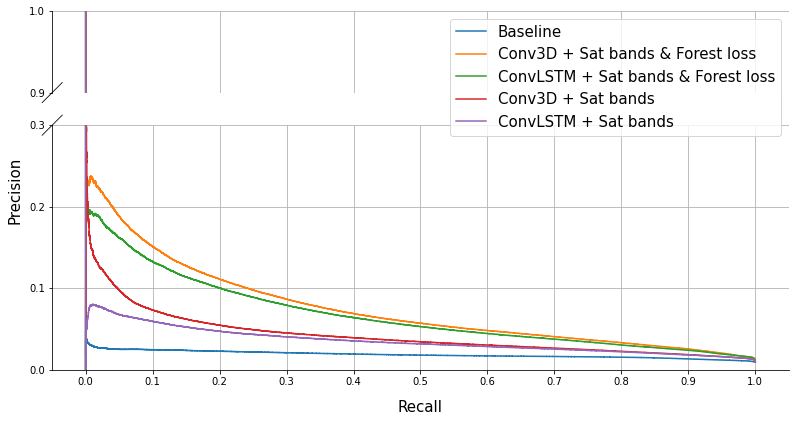

In [49]:
fig = plt.figure(figsize=(12*1.1,6*1.1))
baxes = brokenaxes(ylims=((.0,.3),(0.9,1)), hspace=.2)
baxes.set_xlabel('Recall',  fontsize=15, labelpad = 10)
baxes.set_ylabel('Precision',  fontsize=15)

#plt.xlim([0.0, 1.0])
plots = []
for key in title_mapping:
    value = pr_curves[key]
    baxes.plot(value[1], value[0], label=title_mapping[key], color=color_mapping[key])
leg = baxes.legend(loc="best",  fontsize=15)

baxes.grid()

for lh in leg.legendHandles: 
    lh._legmarker.set_alpha(1)


baxes.axs[1].set_yticks(np.linspace(0.0, 0.3, num=4))
baxes.axs[0].set_yticks(np.linspace(0.9, 1.0, num=2))

baxes.axs[1].set_xticks(np.linspace(0.0, 1.0, num=11))

plt.show()

In [ ]:
fig.savefig('pr_recall.png', bbox_inches="tight")

In [50]:
def get_thr_f1(dl_runhandler, dl_model):
    results = dl_model.evaluate(dl_runhandler.datasets['test'])
    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
    
    
    preds = []
    lbls = []
    for data in dl_runhandler.datasets['test']:
        pred = dl_model.predict(data[0]['in_seq'])
        preds.append(pred)
        
        lbl = data[1]['out']
        lbls.append(lbl)
        
    
    preds = tf.concat(preds, axis=0)
    lbls = tf.concat(lbls, axis=0)
    
    thrs = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
    m = tf.keras.metrics.Precision(thresholds = thrs)
    m.update_state(lbls, preds)
    precision = m.result().numpy()
    
    m = tf.keras.metrics.Recall(thresholds = thrs)
    m.update_state(lbls, preds)
    recall = m.result().numpy()
    
    f1 = (2*precision*recall)/(precision+recall)
    
    return f1

In [51]:
model_types = ['final_fix_spatial_segmenting_future_double_reduced_conv3d', 'final_fix_spatial_segmenting_future_double_reduced_convlstm2d']
data_configs = ['64px_comb_img_only', '64px_comb']

In [52]:
model_types = ['final_fix_spatial_segmenting_future_double_reduced_conv3d']
data_configs = ['64px_comb']

In [53]:
model_dict = {}

In [54]:
learning_rates = [0.1, 0.01, 0.001]
betas = [0.995, 0.999, 0.9995,1.0]
dropouts = [0.0, 0.1, 0.2, 0.3]

In [55]:
# for model in model_types:
#     model_dict[model] = {}
#     reuse_dl_runhandler = None
#     for data_config in data_configs:
#         model_dict[model][data_config] = {}
#         for beta in betas:
#             for dropout in dropouts:
#                 for learning_rate in learning_rates:
#                     model_dict[model][data_config][(beta, dropout, learning_rate)] = {}
#                     # Init model
#                     dl_runhandler, dl_model = load_model(model_name, dataset, beta, lr, dropout)
#                     # Append to model dict
                    
                    
#                     model_dict[model][data_config][(beta, dropout, learning_rate)]['model'] = dl_model
#                     model_dict[model][data_config][(beta, dropout, learning_rate)]['run_handler'] = dl_runhandler
                    
#                     if reuse_dl_runhandler is None:
#                         reuse_dl_runhandler = dl_runhandler
                        
#                     f1 = get_thr_f1(reuse_dl_runhandler, dl_model)
                        
#                     model_dict[model][data_config][(beta, dropout, learning_rate)]['f1_results'] = f1
#                     print(model, data_config, (beta, dropout, learning_rate), max(f1))

In [56]:
for dl_model in dl_models:
    dl_runhandler = dl_model['runhandler']
    if 'comb_img_only' in dl_model['dataset']:
        test_dataset = ecoregion_comb_img_only_datasets['test']
    else:
        test_dataset = ecoregion_comb_datasets['test']
    results = dl_model['model'].evaluate(test_dataset, verbose = 0)

    
    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
    f1 = calc_f1(precision, recall)
    print(dl_model['model_name'], dl_model['dataset'])
    print(accuracy, precision, recall, f1)
    
    dl_model['f1_ecoregion'] = f1
    


final_fix_spatial_segmenting_future_double_reduced_conv3d 64px_comb_img_only
0.9619632959365845 0.0404970645904541 0.2436836063861847 0.0694520898521445
final_fix_spatial_segmenting_future_double_reduced_conv3d 64px_comb
0.9883081316947937 0.10724537074565887 0.13751326501369476 0.1205077895869596
final_fix_spatial_segmenting_future_double_reduced_convlstm2d 64px_comb_img_only
0.9538138508796692 0.028216643258929253 0.2072063833475113 0.049669471029812305
final_fix_spatial_segmenting_future_double_reduced_convlstm2d 64px_comb
0.9755445122718811 0.07257330417633057 0.2715294361114502 0.11453432973688848


In [57]:
def get_predictions(point_ids, dl_models):
    predictions = {point:{} for point in point_ids}

    # Dl models
    for dl_model in dl_models:    
        model_name = dl_model['model_name']  + dl_model['dataset']
        found_points = 0
        for data in tqdm(dl_model['runhandler'].datasets['test'], total = 4000/64):
            for point_id in point_ids:
                point_dict = {}
                mask = data[0]['point_id'] == point_id
                mask = tf.reshape(mask, shape = 64)

                lbl = tf.boolean_mask(data[1]['out'], mask)
                feat = tf.boolean_mask(data[0]['in_seq'], mask)
                coords = tf.boolean_mask(data[0]['coords'], mask)

                if len(lbl) > 0:
                    found_points+=1
                    if 'lbl' not in predictions[point_id]:
                        predictions[point_id]['lbl'] = lbl
                        predictions[point_id]['coords'] = coords

                    pred = dl_model['model'].predict(feat)

                    results = dl_model['model'].evaluate(feat, lbl, verbose = 0)
                    _, tp, fp, tn, fn, accuracy, precision, recall, jac_coef_bool, jac_coef, pr_auc = results
                    f1 = calc_f1(precision, recall)


                    if 'preds' not in predictions[point_id]:
                        predictions[point_id]['preds'] = {}
                        predictions[point_id]['feat'] = {}
                        predictions[point_id]['metrics'] = {}

                    predictions[point_id]['preds'][model_name] = pred
                    predictions[point_id]['feat'][model_name] = feat
                    predictions[point_id]['metrics'][model_name] = (accuracy, precision, recall, f1)

            if len(point_ids) == found_points:
                break


    # Baseline model
    for point_id in point_ids:
        # Baseline
        px_ids, features, pred, lbl = prepare_point(baseline_point_index[point_id], baseline_model)
        predictions[point_id]['preds']['baseline'] = pred
        predictions[point_id]['feat']['baseline'] = features
        predictions[point_id]['baseline_lbl'] = lbl
    
    return predictions
    

In [89]:
def predictions_to_img_list(predictions):
    title_mapping = {}
    
    title_mapping['baseline']= 'Baseline'
    title_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb']= 'Best:\n Conv3D'
    title_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb']= 'ConvLSTM'
    
    title_mapping['final_fix_spatial_segmenting_future_double_reduced_conv3d64px_comb_img_only']= 'Conv3D'
    title_mapping['final_fix_spatial_segmenting_future_double_reduced_convlstm2d64px_comb_img_only']= 'ConvLSTM'
        
    img_list = []

    for point, point_value in tqdm(predictions.items(), total = len(predictions)):
        img = tf.reshape(point_value['lbl'],shape=[64,64])
        img_list.append({'image':img, 'title':'Ground truth'})
        #for key, value in point_value['preds'].items(): 
        
        for key, value in title_mapping.items():        
            image = point_value['preds'][key]
            img_list.append({'image':tf.reshape(image,shape=[64,64]), 'title':value
                             , 'feats': point_value['feat'][key] 
                            })
    return img_list

In [59]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import numpy as np
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [60]:
def show_img(fig, ax, image, hex_palette, vmin = None, vmax = None, cat_label = None):
    
    if hex_palette:
        if cat_label:
            newcmp = ListedColormap(hex_palette)
        else:
            newcmp = LinearSegmentedColormap.from_list('new', hex_palette, N=100)

    ax.imshow(image)
    
    # Create colorbar
    if vmin is not None: 
        # setup the normalization and the colormap
        normalize = mcolors.Normalize(vmin=vmin, vmax=vmax)
        colormap = newcmp


        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='5%', pad=0.05)   

        # setup the colorbar
        scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
        fig.colorbar(scalarmappaple, cax=cax, orientation = 'horizontal', fraction=0.057, pad=0.04, ticks=cat_label).ax.tick_params(labelsize=20)
        
    

In [61]:
def create_lbl_comparison(point_ids, dl_models):
    # Get preditions
    predictions = get_predictions(point_ids, dl_models)

    # Get img list
    img_list = predictions_to_img_list(predictions)

    # Generate image
    w, h  = 20, 40
    fig = create_figure(w, h, 6, 10, img_list)

In [62]:
# Best model
# Define best model
best_model = None
best_f1 = 0
for dl_model in dl_models:
    
    if dl_model['f1'] >= best_f1:
        best_model = dl_model
        best_f1 =  dl_model['f1']
    

In [63]:
# Retrieve performance scores for best model
df_scores = get_performance_df(best_model['model'], best_model['runhandler'])

In [64]:
#df_scores = get_performance_df(dl_models[0]['model'], dl_models[0]['runhandler'])

In [65]:
vertical_align_spacings = np.linspace(0.237, 0.925, num=8)
dict(zip(vertical_align_spacings, range(1,9)))

{0.237: 1,
 0.3352857142857143: 2,
 0.4335714285714286: 3,
 0.5318571428571428: 4,
 0.6301428571428571: 5,
 0.7284285714285714: 6,
 0.8267142857142857: 7,
 0.925: 8}

In [66]:
def create_figure(width, heigth, ncols, nrows, feature_images, no_lbl = True):
    fig = plt.figure(figsize=(width,heigth))
    grid_spec = gridspec.GridSpec(ncols=ncols, nrows=nrows, figure=fig)
    
    
    
    vertical_align_spacings = np.linspace(0.237, 0.925, num=8)[::-1]
    vertical_align_spacings = dict(zip(vertical_align_spacings, range(1,9)))
    
    for vertical_align_spacing, value in vertical_align_spacings.items():
        font = {'size': 20}
        fig.text(-0.01, vertical_align_spacing, f'{value}', ha='center', rotation='horizontal', fontdict=font)

        
    hor_align_spacings = []    
    for hor_align_spacing in hor_align_spacings:   
        font = {'size': 20}
        fig.text(hor_align_spacing, 1, f'{hor_align_spacing}', ha='center', rotation='horizontal', fontdict=font)

        

    first_title = True
    # Plot
    i = 0
    for row in range(nrows):
        for col in range(ncols):
            if i < len(feature_images):
                feature_image = feature_images[i]

                title = feature_image['title']
                image = feature_image['image']
                
                thr = 0.5
                image = tf.cast(image >= thr, dtype = tf.float32)
                
                #hex_palette = feature_image['hex_palette']
                hex_palette = None
                
                if 'vmin' in feature_image:
                    vmin = feature_image['vmin']
                    vmax = feature_image['vmax']
                else:
                    vmin = None
                    vmax = None
                ax = fig.add_subplot(grid_spec[row, col])
                if first_title:
                    if 'Best' in title:
                        ax.set_title(title, fontsize=25, fontweight = 'bold')
                    else:
                        ax.set_title(title, fontsize=25)
                ax.axis('off')
                if 'cat_label' in feature_image:
                    cat_label = feature_image['cat_label']
                else:
                    cat_label = None

                show_img(fig, ax, image, hex_palette, vmin, vmax, cat_label)
                i+=1

        first_title = False

    fig.tight_layout()

    font = {'size': 30}
    fig.text(0.5, 1, 'Sat bands & \n forest loss', ha='center', rotation='horizontal', fontdict=font)
    fig.text(0.83, 1, 'Sat bands', ha='center', rotation='horizontal', fontdict=font)
    
    plt.show()
    return fig
    


In [67]:
# Get top 10 points
# Org
#top_points = (df_scores[df_scores['forest_loss_proportion']>0.05].
#              sort_values(by=['f1', 'forest_loss_proportion'], ascending = False)[:8]['point_id']
#              .to_list())


top_points = (df_scores[df_scores['forest_loss_proportion']>0.025].
              sort_values(by=['f1', 'forest_loss_proportion'], ascending = False)[:8]['point_id']
              .to_list())


In [83]:
df_scores[df_scores['forest_loss_proportion']>0.025].sort_values(by=['f1', 'forest_loss_proportion'], ascending = False)

,point_id,coords,tp,fp,tn,fn,accuracy,precision,recall,jac_coef_bool,jac_coef,pr_auc,f1,forest_loss_proportion
1671,b'76340_0_2013_2019',"[-54.071445, -11.948037]",147.0,140.0,3757.0,52.0,0.953125,0.512195,0.738693,0.435294,0.153641,0.594036,0.604938,0.048584
3861,b'4513_0_2013_2019',"[-55.365906, -11.405894]",127.0,94.0,3792.0,83.0,0.956787,0.574661,0.604762,0.419672,0.283233,0.524191,0.589327,0.051270
3311,b'19453_0_2013_2019',"[-54.176556, -10.782418]",85.0,38.0,3883.0,90.0,0.968750,0.691057,0.485714,0.401869,0.176537,0.597748,0.570470,0.042725
1205,b'80661_0_2013_2019',"[-54.04721, -11.951318]",106.0,128.0,3829.0,33.0,0.960693,0.452991,0.762590,0.399254,0.121955,0.643355,0.568365,0.033936
3150,b'36092_0_2013_2019',"[-57.27076, -12.198966]",221.0,101.0,3510.0,264.0,0.910889,0.686335,0.455670,0.378194,0.212432,0.563919,0.547708,0.118408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1448,b'54274_0_2013_2019',"[-54.069218, -11.826554]",0.0,159.0,3831.0,106.0,0.935303,0.000000,0.000000,0.003759,0.026455,0.032363,0.000000,0.025879
3499,b'87660_0_2013_2019',"[-51.60455, -8.606002]",0.0,0.0,3991.0,105.0,0.974365,0.000000,0.000000,0.009434,0.056453,0.118773,0.000000,0.025635
349,b'19116_0_2013_2019',"[-57.490963, -12.445139]",0.0,0.0,3992.0,104.0,0.974609,0.000000,0.000000,0.009524,0.047163,0.229336,0.000000,0.025391
542,b'17482_0_2013_2019',"[-58.893322, -10.799126]",0.0,0.0,3992.0,104.0,0.974609,0.000000,0.000000,0.009524,0.017705,0.029805,0.000000,0.025391


In [84]:
# Get preditions
predictions = get_predictions(top_points, dl_models)

# Get img list
top_img_list = predictions_to_img_list(predictions)



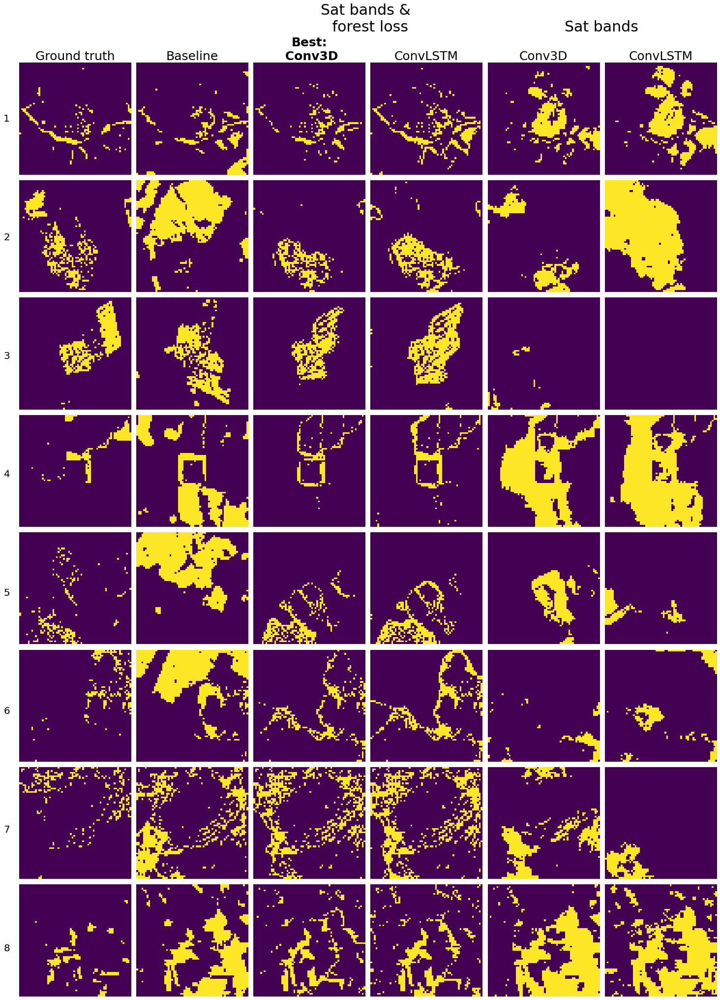

In [86]:
# Generate image
w, h  = 20, 34
fig = create_figure(w, h, 6, 10, top_img_list)

In [ ]:
fig.savefig('top_pred.png', bbox_inches="tight")

In [87]:
# Get flop  points
flop_low_points = (df_scores[df_scores['forest_loss_proportion']<0.01]
                   .sort_values(by=['f1'], ascending = True)
                   .sort_values(by=['forest_loss_proportion'], ascending = False)
                   [:4]['point_id'].to_list())

flop_high_points = (df_scores[df_scores['forest_loss_proportion']>0.01]
                   .sort_values(by=['f1'], ascending = True)
                   .sort_values(by=['forest_loss_proportion'], ascending = False)
                   [:4]['point_id'].to_list())

flop_points = flop_low_points + flop_high_points

In [90]:
# Visualize flop  points
# Get preditions
predictions = get_predictions(flop_points, dl_models)

# Get img list
flop_img_list = predictions_to_img_list(predictions)

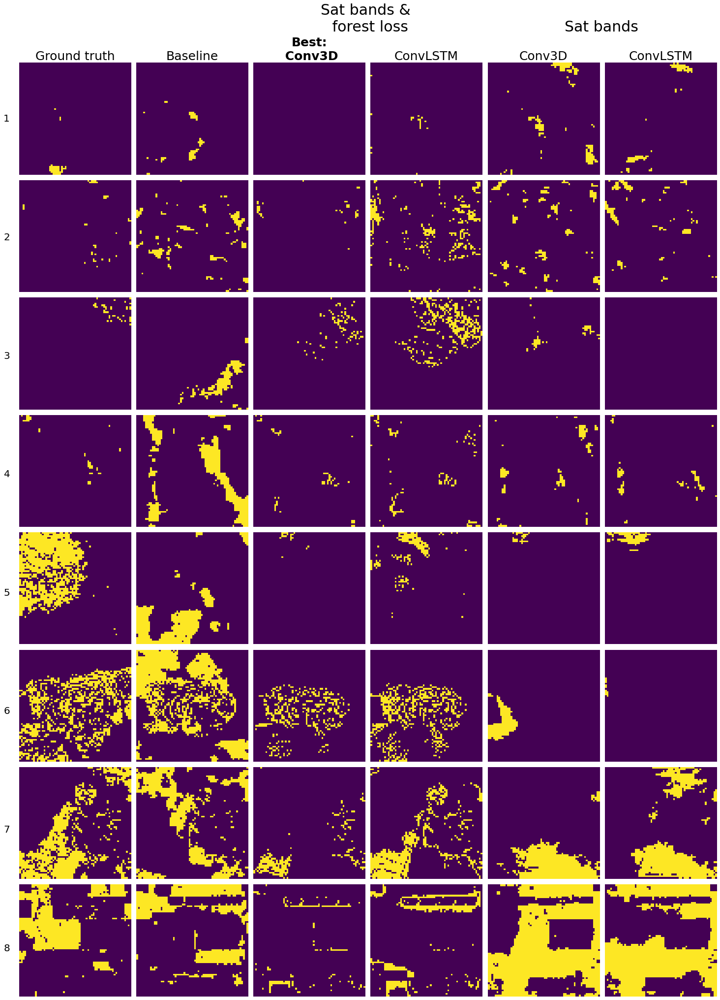

In [91]:
# Generate image
w, h  = 20, 34
fig = create_figure(w, h, 6, 10, flop_img_list)

In [ ]:
fig.savefig('flop_pred.png', bbox_inches="tight")

In [94]:
baseline_point_index

{b'78058_0_2013_2019': {'coords': array([-51.548634, -10.633867], dtype=float32),
  'px_id': [<tf.Tensor: shape=(1518, 1), dtype=float32, numpy=
   array([[0.000e+00],
          [1.000e+00],
          [2.000e+00],
          ...,
          [1.515e+03],
          [1.516e+03],
          [1.517e+03]], dtype=float32)>,
   <tf.Tensor: shape=(1517, 1), dtype=float32, numpy=
   array([[1518.],
          [1519.],
          [1520.],
          ...,
          [3032.],
          [3033.],
          [3034.]], dtype=float32)>,
   <tf.Tensor: shape=(1061, 1), dtype=float32, numpy=
   array([[3035.],
          [3036.],
          [3037.],
          ...,
          [4093.],
          [4094.],
          [4095.]], dtype=float32)>],
  'features': [<tf.Tensor: shape=(1518, 9), dtype=float32, numpy=
   array([[3.24122012e-02, 5.85881889e-01, 0.00000000e+00, ...,
           4.19295162e-01, 1.09411016e-01, 2.37396196e-01],
          [2.85082698e-01, 3.24541122e-01, 0.00000000e+00, ...,
           4.19295162e-01, 

In [ ]:
img_list[-1]['feats']

In [44]:
def reshp_and_show(img):
    img_rshp = tf.reshape(img, (64,64))
    plt.imshow(img_rshp)
    

In [45]:
list(predictions.keys())[4]

b'70621_0_2013_2019'

In [46]:
predictions[b'70621_0_2013_2019']['coords']

<tf.Tensor: shape=(1, 2), dtype=float32, numpy=array([[-55.104946 , -12.3078165]], dtype=float32)>

In [47]:
year = -3

In [48]:
img_list[1]['feats'][:,:,0]

<tf.Tensor: shape=(64, 64), dtype=float32, numpy=
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>

In [53]:
# Get check datapoints for fixed dataset
#Init points
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/baseline/2013_2019_fixed/64px_baseline',
                                        baseline=True, check_dataset = True,
                                        train_batch_size = 64, val_test_batch_size = 64*64*10,
                                        mode = '64px')
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True        
check_dataset = load_dataset_helper.get_datasets()

In [54]:
forbid_keys = ['coords', 'forest_loss_proportion_all', 'forest_loss_proportion_last_years', 'label_forest_loss', 'point', 'px_id']

In [56]:
new_dataset = []
for data_point in tqdm(check_dataset['test']):
    forbid_keys = ['coords', 'forest_loss_proportion_all', 'forest_loss_proportion_last_years', 'label_forest_loss', 'point_id', 'px_id']
    keys = [key for key in data_point.keys() if key not in forbid_keys]
    data = []
    data.append({})
    data.append({})
        
    data[0]['point_id'] = data_point['point_id']
    data[0]['px_id'] = data_point['px_id']
    feat_list = [data_point[key] for key in keys]
    data[0]['in_bas'] = tf.concat(feat_list, axis = -1)
    data[1]['out']  = data_point['label_forest_loss']
    data[0]['coords'] = data_point['coords']
    
    new_dataset.append(data)

In [57]:
new_dataset_index = index_test_dataset(new_dataset, 64*64*10)

In [58]:
test_point = flop_points[4]

In [60]:
def prepare_point(point_dict, baseline_model):
    px_ids = tf.concat(point_dict['px_id'], axis = 0)
    lbl = tf.concat(point_dict['lbl'], axis = 0)
    features = tf.concat(point_dict['features'], axis = 0)
    
    all_loss = tf.concat(point_dict['features'], axis = 0)
    
    pred = baseline_model.predict(features)
    
    # Sanity check
    for i, px_id in enumerate(px_ids):
        if i != px_id:
            print('Error in pixel order!')
            
    lbl = tf.reshape(lbl, shape = (64,64,1))
    features = tf.reshape(features, shape = (64,64,9))
    pred = tf.reshape(pred, shape = (64,64,1))
    
    return (px_ids, features, pred, lbl)

(px_ids, features, pred, lbl) = prepare_point(new_dataset_index[test_point], baseline_model)

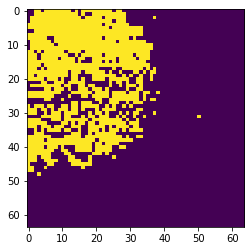

In [61]:
reshp_and_show(lbl)

(None, 'dist_to_forest_loss')

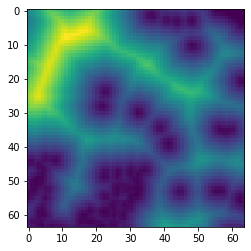

In [67]:
feat_num = 1
reshp_and_show(features[:,:,feat_num]), keys[feat_num]

In [ ]:
def index_test_dataset(baseline_test_dataset, shape = 64*64):
    point_dict = {}
    for data in tqdm(baseline_test_dataset): 
        point_ids, _ = tf.unique(tf.reshape(data[0]['point_id'], shape=shape))
        for point_id in point_ids:
            point_id = point_id.numpy()
            px_ids = data[0]['px_id']
            in_bas = data[0]['in_bas']
            lbl = data[1]['out']
            coords = data[0]['coords']

            mask = data[0]['point_id'] == point_id
            mask = tf.reshape(mask, shape = shape)

            px_ids = tf.boolean_mask(px_ids, mask)
            features = tf.boolean_mask(in_bas, mask)
            lbl = tf.boolean_mask(lbl, mask)
            coords = tf.boolean_mask(coords, mask)

            if point_id not in point_dict:
                point_dict[point_id] = {}
                point_dict[point_id]['coords'] = np.unique(coords.numpy())
                point_dict[point_id]['px_id'] = []
                point_dict[point_id]['features'] = []
                point_dict[point_id]['lbl'] = []
                point_dict[point_id]['collected_pxs'] = 0
            point_dict[point_id]['px_id'].append(px_ids)
            point_dict[point_id]['features'].append(features)
            point_dict[point_id]['lbl'].append(lbl)
            point_dict[point_id]['collected_pxs']+= len(px_ids)
            
        
    return point_dict

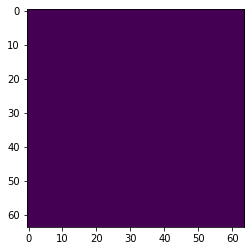

In [871]:
band = 6
year = -6
reshp_and_show(img_list[2+4*6]['feats'][:,year,:,:,band])


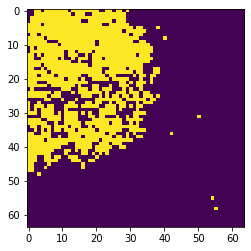

In [862]:
reshp_and_show(img_list[0+4*6]['image'])

In [639]:
predictions

{b'46699_0_2013_2019': {'lbl': <tf.Tensor: shape=(1, 64, 64, 1), dtype=float32, numpy=
  array([[[[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]],
  
          [[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]],
  
          [[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]],
  
          ...,
  
          [[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]],
  
          [[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]],
  
          [[0.],
           [0.],
           [0.],
           ...,
           [0.],
           [0.],
           [0.]]]], dtype=float32)>,
  'coords': <tf.Tensor: shape=(1, 2), dtype=float32, numpy=array([[-63.912598, -15.314423]], dtype=float32)>,
  'preds': {'final_fix_spatial_segmen

In [ ]:
def create_figure(width, heigth, ncols, nrows, feature_images, no_lbl = True):
    fig = plt.figure(figsize=(width,heigth))
    grid_spec = gridspec.GridSpec(ncols=ncols, nrows=nrows, figure=fig)
    
    
    
    vertical_align_spacings = np.linspace(0.237, 0.925, num=8)[::-1]
    vertical_align_spacings = dict(zip(vertical_align_spacings, range(1,9)))
    
    for vertical_align_spacing, value in vertical_align_spacings.items():
        font = {'size': 20}
        fig.text(-0.01, vertical_align_spacing, f'{value}', ha='center', rotation='horizontal', fontdict=font)

        
    hor_align_spacings = []    
    for hor_align_spacing in hor_align_spacings:   
        font = {'size': 20}
        fig.text(hor_align_spacing, 1, f'{hor_align_spacing}', ha='center', rotation='horizontal', fontdict=font)

        

    first_title = True
    # Plot
    i = 0
    for row in range(nrows):
        for col in range(ncols):
            if i < len(feature_images):
                feature_image = feature_images[i]

                title = feature_image['title']
                image = feature_image['image']
                
                thr = 0.5
                image = tf.cast(image >= thr, dtype = tf.float32)
                
                #hex_palette = feature_image['hex_palette']
                hex_palette = None
                
                if 'vmin' in feature_image:
                    vmin = feature_image['vmin']
                    vmax = feature_image['vmax']
                else:
                    vmin = None
                    vmax = None
                ax = fig.add_subplot(grid_spec[row, col])
                if first_title:
                    if 'Best' in title:
                        ax.set_title(title, fontsize=25, fontweight = 'bold')
                    else:
                        ax.set_title(title, fontsize=25)
                ax.axis('off')
                if 'cat_label' in feature_image:
                    cat_label = feature_image['cat_label']
                else:
                    cat_label = None

                show_img(fig, ax, image, hex_palette, vmin, vmax, cat_label)
                i+=1

        first_title = False

    fig.tight_layout()

    font = {'size': 30}
    fig.text(0.5, 1, 'Sat bands & \n forest loss', ha='center', rotation='horizontal', fontdict=font)
    fig.text(0.83, 1, 'Sat bands', ha='center', rotation='horizontal', fontdict=font)
    
    plt.show()
    return fig
    


# Calculate PR Curve, AUC-ROC

In [810]:
baseline_point_index, baseline_model

KeyboardInterrupt: 

In [826]:
lbls = []
preds = []
feats = []
for point, value in tqdm(baseline_point_index.items()):
    feat = tf.concat(value['features'], axis = 0)
    lbl = tf.concat(value['lbl'], axis = 0)
    #pred = baseline_model.predict(feat)
    lbls.append(lbl)
    #preds.append(pred)
    feats.append(feat)

#preds = tf.concat(preds, axis =0)
lbls = tf.concat(lbls, axis =0)  
feats = tf.concat(feats, axis =0)  

In [828]:
preds = baseline_model.predict(feats)

In [835]:
thrs = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
m = tf.keras.metrics.Precision(thresholds = thrs)
m.update_state(lbls, preds)
precision = m.result().numpy()

m = tf.keras.metrics.Recall(thresholds = thrs)
m.update_state(lbls, preds)
recall = m.result().numpy()

f1 = (2*precision*recall)/(precision+recall)
f1

array([0.02048   , 0.06360627, 0.07014053, 0.07247491, 0.07284602,
       0.07207207, 0.06943193, 0.06385849, 0.03708335], dtype=float32)

In [839]:
recall

array([1.        , 0.990468  , 0.95124876, 0.89669496, 0.83083105,
       0.75621825, 0.6630165 , 0.52691746, 0.05215962], dtype=float32)

In [830]:
print(sklearn.metrics.roc_auc_score(lbls, preds))

0.8662421667603223


In [833]:
print(sklearn.metrics.f1_score(lbls, tf.cast(preds>= 0.4, dtype=tf.float32)))

0.07247491857421083


In [823]:

for dl_model in dl_models:
    lbls = dl_model['lbls'].numpy().flatten()
    preds = dl_model['preds'].numpy().flatten()

    print(sklearn.metrics.roc_auc_score(lbls, preds))

<module 'model_baseline' from '/home/christian.kemper/repos/satseq/model_baseline.py'>

# In detail analysis

### Init baseline

In [ ]:
# Prepare baseline point
px_ids, features, pred, lbl = prepare_point(point_dict[b'78058_0_2013_2019'])

In [ ]:
plt.imshow(img_adjust_gamma(img))

In [ ]:
data[0]['point_id']
mask = data[0]['point_id'] == b'53940_0_2013_2019'
mask = tf.reshape(mask, shape = 64)

lbl = data[0]['in_seq']
lbl = tf.boolean_mask(lbl, mask)

In [ ]:
feat

In [ ]:
point_id = b'78058_0_2013_2019'
for data in dl_runhandler.datasets['test']:
    if tf.reduce_sum(tf.cast(data[0]['point_id']==point_id, dtype=tf.float32)) > 0:
        break

In [ ]:
mask = data[0]['point_id'] == point_id
mask = tf.reshape(mask, shape = 64)

lbl = data[1]['out']
lbl = tf.boolean_mask(lbl, mask)

In [ ]:
plt.imshow(np.reshape(lbl, newshape = [64, 64]))

In [ ]:
# model.load_weights('models/final_baseline/64px/weights/beta_0.0_learning_rate_0.001/best_model.h5')

# model.predict()

In [ ]:
def get_class_weights_and_bias(beta):
    samples_per_cls = np.array([64*64*0.991, 64*64*0.009])
    n_classes = 2
    total_n = (64*64)

    # Calculate class weights
    if beta == 1:
        weights = (total_n)/samples_per_cls
    else:
        effective_num = 1.0 - np.power(beta, samples_per_cls)
        weights = (1.0 - beta)/np.array(effective_num)
    class_weights = weights / np.sum(weights) * n_classes

    return class_weights

In [ ]:
for beta in [0.0, 0.9, 0.99, 0.995, 0.999, 0.9995, 0.9999, 1.0]:
    print(get_class_weights_and_bias(beta))

In [ ]:
dl_runhandler = models.RunHandler(model_name = 'final_spatial_segmenting_future_double_reduced_conv3d', mode = '64px_comb')
hparams = {
            models.HP_DROPOUT: 0.2,
            models.HP_BETA: 0.995,
            models.HP_LEARNING_RATE: 0.01,
            }
model = models.get_model(dl_runhandler.model_name, dl_runhandler.keras_norm_params, dl_runhandler.mode, hparams, dl_runhandler.tile_size)

In [ ]:
from load_dataset import LoadDatasetHelper
load_dataset_helper = LoadDatasetHelper(file_path='data/datasets/main/2013_2019/64px_comb',
                                    baseline=False,
                                    check_dataset = True,
                                    train_batch_size = 64,
                                    val_test_batch_size= 64,
                                    mode = '64px_comb'
                                    )
load_dataset_helper.sample_weights = []
load_dataset_helper.normalization = True
load_dataset_helper.complete_label = False
load_dataset_helper.kernel_size = 64
datasets = load_dataset_helper.get_datasets()

In [ ]:
for data in datasets['test']:
    break

In [ ]:
red = tf.reshape(data[1]['RED'], shape = data[1]['RED'].shape+1)
green = tf.reshape(data[1]['GREEN'], shape = data[1]['GREEN'].shape+1)
blue = tf.reshape(data[1]['BLUE'], shape = data[1]['BLUE'].shape+1)

rgb = tf.concat([red, green, blue], axis=-1)

In [ ]:
plt.imshow(rgb[6,-1,:,:,:])

# RGB stuff

In [ ]:
img = rgb[4,-1,:,:,:]*3000
max_pixel = 500


def adjust_gamma(img, max_pixel):
    # Apply log transform. 
    c = max_pixel/(np.log(1 + np.max(img))) 
    log_transformed = c * np.log(1 + img) 

    # Specify the data type. 
    log_transformed = np.array(log_transformed, dtype = np.uint8) 
    
    return log_transformed

img = adjust_gamma(img, max_pixel)
plt.imshow(log_transformed)

In [ ]:
data[0]['coords'][6]

In [ ]:
np.max(img)

In [ ]:
test_point = ee.Geometry.Point([-63.41974027942962,-9.247989737470059])
clip_geometry = ee.FeatureCollection(test_point.buffer((30*256)/2).bounds())
centroid =  test_point
zoom = 13
center = centroid['coordinates'][::-1]
w,h = 480, 138
crop_size = (w, h, w+407, h+407)

In [ ]:
plt.imshow(log_transformed)

In [ ]:
var visParams = {
  bands: ['B4', 'B3', 'B2'],
  min: 0,
  max: 3000,
  gamma: 1.4,
};